# Ensemble model - analysis

In [ ]:
!pip install torch torchvision ultralytics pandas numpy scikit-learn deap opencv-python plotly 

In [ ]:
import os
import cv2
import torch
import timm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from tqdm import tqdm
from PIL import Image, ImageDraw, ImageFont
from torchvision import transforms
from ultralytics import YOLO

import plotly.graph_objects as go
import plotly.subplots as sp
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score, accuracy_score, precision_recall_curve

In [ ]:
def compute_overlap(pos_scores, neg_scores, bins=20):
    pos_hist, bin_edges = np.histogram(pos_scores, bins=bins, range=(0, 1), density=True)
    neg_hist, _ = np.histogram(neg_scores, bins=bins, range=(0, 1), density=True)
    overlap = np.sum(np.minimum(pos_hist, neg_hist)) * (bin_edges[1] - bin_edges[0])
    return overlap * 100

def evaluate_and_plot_plotly(df, nazov, threshold=0.5):
    y_true, y_scores = df['true_label'].values, df['confidence'].values

    precision_vals, recall_vals, thresholds = precision_recall_curve(y_true, y_scores)
    f1_scores = 2 * (precision_vals * recall_vals) / (precision_vals + recall_vals + 1e-6)

    max_f1_idx = np.argmax(f1_scores)
    best_f1_precision = precision_vals[max_f1_idx]
    best_f1_recall = recall_vals[max_f1_idx]

    max_precision_idx = np.argmax(precision_vals)
    best_prec_precision = precision_vals[max_precision_idx]
    best_prec_recall = recall_vals[max_precision_idx]

    y_pred = (y_scores >= threshold).astype(int)
    cm = confusion_matrix(y_true, y_pred, labels=[1, 0])
    TP, FN = cm[0]
    FP, TN = cm[1]

    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    accuracy = accuracy_score(y_true, y_pred)

    pos_scores = y_scores[y_true == 1]
    neg_scores = y_scores[y_true == 0]
    overlap_percent = compute_overlap(pos_scores, neg_scores) 

    cm_text = np.array([
        [f"TP = {TP}", f"FN = {FN}"],
        [f"FP = {FP}", f"TN = {TN}"] 
    ])

    cm_reordered = np.array([
        [TP, FN],
        [FP, TN]
    ])

    royal_blue = '#4169E1'
    yellow = '#FFD700'
    light_gray = '#F5F5F5'

    fig = sp.make_subplots(
        rows=1, cols=3,
        subplot_titles=(
            f"Chybová matica (Prah {threshold:.2f})",
            "PR Krivka",
            f"Distribúcia Pravdepodobností<br>Prekrytie: {overlap_percent:.2f}%"
        )
    )

    heatmap = go.Heatmap(
        z=cm_reordered,
        colorscale=[[0, light_gray], [1, royal_blue]],
        showscale=False,
        text=cm_text,
        texttemplate="%{text}"
    )

    fig.add_trace(heatmap, row=1, col=1)

    fig.add_annotation(
        x=-1.1, y=0.5, text="Skutočnosť",
        showarrow=False, font=dict(size=16), textangle=-90,
        xanchor="center", yanchor="middle", row=1, col=1
    )

    fig.add_annotation(
        x=0.5, y=2, text="Predikcia",
        showarrow=False, font=dict(size=16),
        xanchor="center", row=1, col=1
    )

    fig.add_annotation(
        x=0, y=1.7, text="S meteorom",
        showarrow=False, font=dict(size=14),
        xanchor="center", row=1, col=1
    )

    fig.add_annotation(
        x=1, y=1.7, text="Bez meteoru",
        showarrow=False, font=dict(size=14),
        xanchor="center", row=1, col=1
    )

    fig.add_annotation(
        x=-0.8, y=0, text="Bez meteoru",
        showarrow=False, font=dict(size=14), textangle=-90,
        yanchor="middle", xanchor="center", row=1, col=1
    )

    fig.add_annotation(
        x=-0.8, y=1, text="S meteorom",
        showarrow=False, font=dict(size=14), textangle=-90,
        yanchor="middle", xanchor="center", row=1, col=1
    )

    fig.add_trace(
        go.Scatter(
            x=recall_vals, y=precision_vals,
            mode='lines', line=dict(color=royal_blue, width=3),
            name='PR Krivka'
        ),
        row=1, col=2
    )

    fig.add_trace(
        go.Scatter(
            x=[best_f1_recall], y=[best_f1_precision],
            mode='markers+text', marker=dict(color=yellow, size=12, symbol='circle'),
            text=["Max F1 Skóre"], textposition="bottom left",
            name='Max F1 Skóre'
        ),
        row=1, col=2
    )

    fig.add_trace(
        go.Scatter(
            x=[best_prec_recall],
            y=[best_prec_precision],
            mode='markers+text',
            marker=dict(color=yellow, size=12, symbol='diamond'),
            text=["Max Presnosť"],
            textposition="top right",
            name='Max Presnosť'
        ),
        row=1, col=2
    )

    threshold_idx = np.argmin(np.abs(thresholds - threshold))
    fig.add_trace(
        go.Scatter(
            x=[recall_vals[threshold_idx]], 
            y=[precision_vals[threshold_idx]],
            mode='markers+text',
            marker=dict(color='black', size=12, symbol='circle'),
            text=[f"Prah {threshold:.2f}"], textposition="top left",
            name='Prah'
        ),
        row=1, col=2
    )

    fig.add_trace(
        go.Histogram(
            x=pos_scores, name='S meteorom',
            marker_color=royal_blue, opacity=0.75, nbinsx=20, showlegend=True
        ),
        row=1, col=3
    )

    fig.add_trace(
        go.Histogram(
            x=neg_scores, name='Bez meteoru',
            marker_color=yellow, opacity=0.75, nbinsx=20, showlegend=True
        ),
        row=1, col=3
    )

    fig.add_shape(
        type="line",
        x0=threshold, x1=threshold,
        y0=0, y1=1,
        line=dict(color="black", width=2, dash="dash"),
        xref='x3',
        yref='paper'
    )

    fig.update_layout(
        title=dict(
            text="Vyhodnotenie modelu: " + nazov,
            x=0.5, xanchor='center',
            font=dict(size=20)
        ),
        width=1600, height=450,
        barmode='overlay',
        plot_bgcolor=light_gray,
        paper_bgcolor='white',
        font=dict(size=13, color='black'),
        margin=dict(l=100, r=2, t=100, b=20),
        legend=dict(orientation="h", yanchor="bottom", y=1.05, xanchor="center", x=0.5)
    )

    fig.update_xaxes(showgrid=False)
    fig.update_yaxes(showgrid=False)

    fig.update_xaxes(title_text="Návratnosť (Recall)", row=1, col=2)
    fig.update_yaxes(title_text="Presnosť (Precision)", row=1, col=2)
    fig.update_xaxes(title_text="Pravdepodobnosť meteoru", row=1, col=3)
    fig.update_yaxes(title_text="Počet obrázkov", row=1, col=3)

    fig.update_xaxes(zeroline=False, row=1, col=1, showticklabels=False) 
    fig.update_yaxes(zeroline=False, row=1, col=1, showticklabels=False)
    
    fig.update_xaxes(zeroline=False, row=1, col=2, showticklabels=True)
    fig.update_yaxes(zeroline=False, row=1, col=2, showticklabels=True)
    
    fig.update_xaxes(zeroline=False, row=1, col=3, showticklabels=True)
    fig.update_yaxes(zeroline=False, row=1, col=3, showticklabels=True)

    print(f"\n🔑 Výsledky pre prah {threshold:.2f}:")
    print(f"➡️ TP (Správne meteory): {TP}")
    print(f"➡️ TN (Správne nemeteory): {TN}")
    print(f"➡️ FP (Falošné meteory): {FP}")
    print(f"➡️ FN (Nezachytené meteory): {FN}")
    print(f"➡️ Presnosť (Precision): {precision:.4f}")
    print(f"➡️ Návratnosť (Recall): {recall:.4f}")
    print(f"➡️ F1-Skóre: {f1:.4f}")
    print(f"➡️ Presnosť klasifikácie (Accuracy): {accuracy:.4f}")
    print(f"➡️ Prekrytie distribúcie (Overlap coefficient): {overlap_percent:.2f}%")

    fig.show()

    print(f"\n🔵 Max F1 bod: Návratnosť={best_f1_recall:.3f}, Presnosť={best_f1_precision:.3f}")
    print(f"🟡 Max Presnosť bod: Návratnosť={best_prec_recall:.3f}, Presnosť={best_prec_precision:.3f}")

In [ ]:
df = pd.read_csv("/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/ensemble_learning/all_predictions_yolov11_yolov12_convnextv65_efficientNetB4.csv")

model_metrics = {
    'convnexts': {'overlap': 0.1294},
    'efficientnetb4': {'overlap': 0.1836},
    'yolov11': {'overlap': 0.1079},
    'yolov12': {'overlap': 0.1174},
}

# Boost for models
performance_boost = {
    'efficientnetb4': 1.00,
    'convnexts': 1.10,
    'yolov12': 1.15,
    'yolov11': 1.30
}

# Overlap penalisation and performance-based advantage
alpha = 1.02  # noise
weights = {}
for model, metrics in model_metrics.items():
    base = (1 - metrics['overlap']) ** alpha
    boost = performance_boost[model]
    weights[model] = base * boost

# Norm weights
total_weight = sum(weights.values())
weights = {model: w / total_weight for model, w in weights.items()}

print("✅ Kombinované váhy (overlap + výkonnosť):")
for model, w in weights.items():
    print(f"  {model}: {w:.4f}")

df["ensemble_probability"] = (
    df["prediction_EfficientNetB4"] * weights["efficientnetb4"] +
    df["prediction_ConvNexts"] * weights["convnexts"] +
    df["prediction_yolov11"] * weights["yolov11"] +
    df["prediction_yolov12"] * weights["yolov12"] 
)

threshold = 0.34
df["ensemble_prediction"] = (df["ensemble_probability"] >= threshold).astype(int)

print("\n📊 Správa klasifikácie (Ensemble model):")
print(classification_report(df["true_label"], df["ensemble_prediction"], digits=4))

def compute_overlap(p1, p2, bins=50):
    h1, _ = np.histogram(p1, bins=bins, range=(0, 1), density=True)
    h2, _ = np.histogram(p2, bins=bins, range=(0, 1), density=True)
    return np.sum(np.minimum(h1, h2)) * (1 / bins)

meteor_probs = df[df["true_label"] == 1]["ensemble_probability"]
non_meteor_probs = df[df["true_label"] == 0]["ensemble_probability"]

overlap_score = compute_overlap(meteor_probs, non_meteor_probs)
print(f"📉 Prekrytie distribúcií (Overlap coefficient): {overlap_score * 100:.2f}%")


✅ Kombinované váhy (overlap + výkonnosť):
  convnexts: 0.2425
  efficientnetb4: 0.2065
  yolov11: 0.2939
  yolov12: 0.2571

📊 Správa klasifikácie (Ensemble model):
              precision    recall  f1-score   support

           0     0.9619    0.9352    0.9484       324
           1     0.9655    0.9800    0.9727       600

    accuracy                         0.9643       924
   macro avg     0.9637    0.9576    0.9605       924
weighted avg     0.9643    0.9643    0.9642       924

📉 Prekrytie distribúcií (Overlap coefficient): 8.31%


In [ ]:
threshold = 0.34

df_preds = pd.DataFrame({
    'true_label': df["true_label"],
    'predicted_label': df["ensemble_prediction"],
    'confidence': df["ensemble_probability"]
})

print(df_preds.head())

evaluate_and_plot_plotly(df_preds, "Posilňované učenie - optimalizované váhy s cieľom posilniť separabilitu tried", threshold)

   true_label  predicted_label  confidence
0           0                0    0.046640
1           0                0    0.074367
2           0                0    0.071835
3           0                0    0.049791
4           0                0    0.056407

🔑 Výsledky pre prah 0.34:
➡️ TP (Správne meteory): 588
➡️ TN (Správne nemeteory): 303
➡️ FP (Falošné meteory): 21
➡️ FN (Nezachytené meteory): 12
➡️ Presnosť (Precision): 0.9655
➡️ Návratnosť (Recall): 0.9800
➡️ F1-Skóre: 0.9727
➡️ Presnosť klasifikácie (Accuracy): 0.9643
➡️ Prekrytie distribúcie (Overlap coefficient): 8.31%



🔵 Max F1 bod: Návratnosť=0.980, Presnosť=0.966
🟡 Max Presnosť bod: Návratnosť=0.437, Presnosť=1.000


In [ ]:
threshold = 0.34

# Filter rows where there was misclassification and confidence > threshold
filtered_df = df[
    (df["ensemble_prediction"] != df["true_label"]) &
    (df["ensemble_probability"] > threshold)
]

print("❌ Nesprávne klasifikované riadky s confidence nad thresholdom:")
filtered_df

❌ Nesprávne klasifikované riadky s confidence nad thresholdom:


,image_name,true_label,prediction_ConvNexts,prediction_yolov11,prediction_yolov12,prediction_EfficientNetB4,ensemble_probability,ensemble_prediction
227,222523_VAZEC.jpg,0,0.591383,0.284939,0.000000,0.707149,0.373181,1
233,223425_ARBO.jpg,0,0.914398,0.342448,0.395225,0.175672,0.460297,1
878,nemet_M20210710_235123_FO_P.jpg,0,0.866695,0.329445,0.414227,0.054311,0.424732,1
879,nemet_M20210712_222713_FO_P.jpg,0,0.928295,0.300552,0.399076,0.641149,0.548464,1
880,nemet_M20210712_223255_FO_P.jpg,0,0.809245,0.376804,0.412141,0.515613,0.519434,1
886,nemet_M20210714_214406_FO_P.jpg,0,0.680190,0.301284,0.320050,0.224439,0.382138,1
897,nemet_M20210721_012532_FO_P.jpg,0,0.791338,0.343528,0.369646,0.251764,0.439904,1
899,nemet_M20210722_000759_FO_P.jpg,0,0.771641,0.350216,0.343583,0.236788,0.427298,1
900,nemet_M20210722_003702_FO_P.jpg,0,0.771227,0.446849,0.526829,0.655557,0.589183,1
901,nemet_M20210722_014038_FO_P.jpg,0,0.814725,0.351807,0.381665,0.283964,0.457748,1


In [11]:
threshold = 0.34

tp_df = df[
    (df["ensemble_probability"] > threshold) &
    (df["ensemble_probability"] < 0.35)
]
tp_df

,image_name,true_label,prediction_ConvNexts,prediction_yolov11,prediction_yolov12,prediction_EfficientNetB4,ensemble_probability,ensemble_prediction
750,M20211105_031136_AMOS-CE_P.jpg,1,0.588644,0.282797,0.300727,0.187760,0.341961,1
919,nemet_M20211104_222646_AMOS-CE_P.jpg,0,0.770445,0.000000,0.000000,0.781784,0.348291,1


In [ ]:
image_names = filtered_df["image_name"]
convnext_preds = filtered_df["prediction_ConvNexts"]
efficientnet_preds = filtered_df["prediction_EfficientNetB4"]
yolo11_preds = filtered_df["prediction_yolov11"]
yolo12_preds = filtered_df["prediction_yolov12"]
ensemble_predictions = filtered_df["ensemble_probability"]

royal_blue = '#4169E1'
yellow = '#FFD700'
light_gray = '#F5F5F5'
magenta = '#E34FDC'
green = '#47D45A'

fig = go.Figure()

fig.add_trace(go.Bar(x=image_names, y=convnext_preds, name="ConvNext-S", marker_color=royal_blue))
fig.add_trace(go.Bar(x=image_names, y=efficientnet_preds, name="EfficientNet-B4", marker_color="salmon"))
fig.add_trace(go.Bar(x=image_names, y=yolo11_preds, name="YOLOv11", marker_color=yellow))
fig.add_trace(go.Bar(x=image_names, y=yolo12_preds, name="YOLOv12", marker_color=green))

fig.add_trace(go.Scatter(x=image_names, y=ensemble_predictions, mode='lines+markers',
                         name="Kombinovaná pravdepodobnosť",
                         line=dict(color=magenta, width=2), marker=dict(size=6)))

fig.add_shape(
    type="line",
    x0=-0.5, x1=len(image_names)-0.5,
    y0=0.34, y1=0.34,
    line=dict(color="black", width=2, dash="dash")
)

fig.add_trace(go.Scatter(
    x=[None], y=[None],
    mode='lines',
    line=dict(color="black", width=2, dash="dash"),
    name="Prah 0.34"
))

fig.update_layout(
    title="Analýza falošne pozitívnych predikcií po aplikovaní posilňovaného učenia",
    xaxis_title="Obrázky",
    yaxis_title="Predikované pravdepodobnosti",
    xaxis_tickangle=-90,
    barmode='group',
    plot_bgcolor=light_gray,
    legend_title="Modely",
    width=1200,
    height=600
)

fig.show()


In [ ]:
threshold = 0.35

filtered_df["abs_deviation_from_threshold"] = np.abs(filtered_df["ensemble_probability"] - threshold)

mean_dev = filtered_df["abs_deviation_from_threshold"].mean()
median_dev = filtered_df["abs_deviation_from_threshold"].median()
std_dev = filtered_df["abs_deviation_from_threshold"].std()
min_dev = filtered_df["abs_deviation_from_threshold"].min()
max_dev = filtered_df["abs_deviation_from_threshold"].max()

# Proportion of uncertain predictions near the threshold (e.g. ±0.05)
near_threshold = filtered_df["abs_deviation_from_threshold"] <= 0.05
percentage_near = near_threshold.mean() * 100

print("📊 Štatistická analýza odchýlky kombinovanej pravdepodobnosti od prahu:")
print(f"➡️ Priemerná odchýlka:        {mean_dev:.4f}")
print(f"➡️ Mediánová odchýlka:        {median_dev:.4f}")
print(f"➡️ Štandardná odchýlka:       {std_dev:.4f}")
print(f"➡️ Minimálna odchýlka:        {min_dev:.4f}")
print(f"➡️ Maximálna odchýlka:        {max_dev:.4f}")
print(f"⚠️ Podiel neistých predikcií (±0.05): {percentage_near:.2f}%")

📊 Štatistická analýza odchýlky kombinovanej pravdepodobnosti od prahu:
➡️ Priemerná odchýlka:        0.1714
➡️ Mediánová odchýlka:        0.1970
➡️ Štandardná odchýlka:       0.0860
➡️ Minimálna odchýlka:        0.0139
➡️ Maximálna odchýlka:        0.3532
⚠️ Podiel neistých predikcií (±0.05): 4.17%


/tmp/ipykernel_5859/4022941370.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Rendering predictions without combined model

In [ ]:
test_images_dir = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/najlepsie_modely/vyhodnotenie/test_yolo/images"
#test_images_dir = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/DP_rozdelenie_dat/data/test/images"
output_dir = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/ensemble_learning/true_positives"

model_path_convnext = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/najlepsie_modely/najlepsie_modely/datasetv2_best_convnext_model_v5.pth"
model_path_yolov12 = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/najlepsie_modely/najlepsie_modely/yolov12_vacsie_obrazky.pt"
model_path_yolov11 = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/najlepsie_modely/najlepsie_modely/yolov11_vacsie_obrazky.pt"

royal_blue = (225, 105, 65)  # ConvNeXt
yellow = (0, 215, 255)       # YOLOv11
green = (90, 212, 71)        # YOLOv12

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

convnext_model = timm.create_model("convnext_small", pretrained=False, num_classes=1).to(device)
convnext_model.classifier = torch.nn.Sequential(
    torch.nn.Dropout(0.5),
    torch.nn.Linear(convnext_model.num_features, 1)
)
convnext_model.load_state_dict(torch.load(model_path_convnext, map_location=device))
convnext_model.eval()

transform = transforms.Compose([
    transforms.Resize((720, 720)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

yolo_model_11 = YOLO(model_path_yolov11).to(device)
yolo_model_12 = YOLO(model_path_yolov12).to(device)
yolo_model_11.eval()
yolo_model_12.eval()

def predict_convnext(image_path):
    image = Image.open(image_path).convert('RGB')
    image = transform(image).unsqueeze(0).to(device)

    with torch.no_grad():
        output = torch.sigmoid(convnext_model(image))
        probability = output.item()

    return probability

def predict_yolo(image_path, model, threshold=0.3):
    with torch.no_grad():
        results = model(image_path, verbose=False)
        detections = results[0].boxes

    boxes = []
    for det in detections.data.cpu().numpy():
        x1, y1, x2, y2, conf = det[:5]
        if conf > threshold:
            boxes.append((x1, y1, x2, y2, conf))
    
    return boxes

os.makedirs(output_dir, exist_ok=True)

for img_name in tqdm(filtered_df["image_name"], desc="Spracovanie TP obrázkov"):
    img_path = os.path.join(test_images_dir, img_name)

    if not os.path.exists(img_path):
        print(f"Obrázok {img_name} neexistuje, preskakujem.")
        continue

    pred_convnext = predict_convnext(img_path)
    pred_yolo11 = predict_yolo(img_path, yolo_model_11, threshold=0.2)
    pred_yolo12 = predict_yolo(img_path, yolo_model_12, threshold=0.2)

    image = cv2.imread(img_path)
    original_height, original_width = image.shape[:2]  # Original size of the test image
    
    target_width, target_height = 1280, 960
    
    # Scale factor
    scale_x = target_width / original_width
    scale_y = target_height / original_height
    
    # Resize image
    image = cv2.resize(image, (target_width, target_height))
    
    # Frame image for ConvNeXt (royal_blue)
    border_thickness = 10
    image = cv2.copyMakeBorder(image, border_thickness, border_thickness, border_thickness, border_thickness, 
                               cv2.BORDER_CONSTANT, value=royal_blue)
    
    text = f"ConvNeXt: {pred_convnext:.2f}"
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(image, text, (10, 50), font, 1, royal_blue, 2, cv2.LINE_AA)
    
    # Bounding boxes for YOLO models - conversion of relative coordinates to absolute
    def convert_yolo_bbox(x_center, y_center, width, height, img_width, img_height):
        x1 = int((x_center - width / 2) * img_width)
        y1 = int((y_center - height / 2) * img_height)
        x2 = int((x_center + width / 2) * img_width)
        y2 = int((y_center + height / 2) * img_height)
        return x1, y1, x2, y2
    
    # Offset
    offset_x = int(0.01 * target_width)   # 1% from 1280
    offset_y = int(0.01 * target_height)  # 1% from 960
    
    # Bounding boxes for YOLOv11 (yellow)
    for x1, y1, x2, y2, conf in pred_yolo11:
        # If YOLO returns relative coordinates (0-1), convert them to absolute
        if x1 < 1 and y1 < 1 and x2 < 1 and y2 < 1:
            x1, y1, x2, y2 = convert_yolo_bbox(x1, y1, x2-x1, y2-y1, original_width, original_height)
    
        # Convert to final size (1280x960)
        x1, x2 = int(x1 * scale_x) + offset_x, int(x2 * scale_x) + offset_x
        y1, y2 = int(y1 * scale_y) + offset_y, int(y2 * scale_y) + offset_y
        
        cv2.rectangle(image, (x1, y1), (x2, y2), yellow, 2)
        cv2.putText(image, f"{conf:.2f}", (x1, y1 - 5), font, 1, yellow, 2, cv2.LINE_AA)
    
    # Bounding boxes for YOLOv12 (green)
    for x1, y1, x2, y2, conf in pred_yolo12:
        # If YOLO returns relative coordinates (0-1), convert them to absolute
        if x1 < 1 and y1 < 1 and x2 < 1 and y2 < 1:
            x1, y1, x2, y2 = convert_yolo_bbox(x1, y1, x2-x1, y2-y1, original_width, original_height)
    
        # Convert to final size (1280x960)
        x1, x2 = int(x1 * scale_x) + offset_x, int(x2 * scale_x) + offset_x
        y1, y2 = int(y1 * scale_y) + offset_y, int(y2 * scale_y) + offset_y
    
        cv2.rectangle(image, (x1, y1), (x2, y2), green, 2)
        cv2.putText(image, f"{conf:.2f}", (x2 + 5, y2 + 5), font, 1, green, 2, cv2.LINE_AA)

    output_path = os.path.join(output_dir, img_name)
    cv2.imwrite(output_path, image)

print("✅ Všetky sporné obrázky boli spracované a uložené.")


Spracovanie sporných obrázkov: 100%|██████████| 24/24 [01:08<00:00,  2.87s/it]

✅ Všetky sporné obrázky boli spracované a uložené.


Rendering predictions with combined model

In [ ]:
test_images_dir = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/najlepsie_modely/vyhodnotenie/test_yolo/images"
output_dir = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/ensemble_learning/false_positives"
model_path_convnext = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/najlepsie_modely/najlepsie_modely/datasetv2_best_convnext_model_v5.pth"
model_path_yolov12 = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/najlepsie_modely/najlepsie_modely/yolov12_vacsie_obrazky.pt"
model_path_yolov11 = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/najlepsie_modely/najlepsie_modely/yolov11_vacsie_obrazky.pt"
ensemble_csv_path = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/ensemble_learning/all_predictions_ensemble.csv"

royal_blue = (225, 105, 65)  # ConvNeXt
yellow = (0, 215, 255)       # YOLOv11
green = (90, 212, 71)        # YOLOv12
magenta = (220, 79, 227)     # Combined model

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

ensemble_df = pd.read_csv(ensemble_csv_path)

convnext_model = timm.create_model("convnext_small", pretrained=False, num_classes=1).to(device)
convnext_model.classifier = torch.nn.Sequential(
    torch.nn.Dropout(0.5),
    torch.nn.Linear(convnext_model.num_features, 1)
)
convnext_model.load_state_dict(torch.load(model_path_convnext, map_location=device))
convnext_model.eval()

transform = transforms.Compose([
    transforms.Resize((512, 512)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

yolo_model_11 = YOLO(model_path_yolov11).to(device)
yolo_model_12 = YOLO(model_path_yolov12).to(device)
yolo_model_11.eval()
yolo_model_12.eval()

def predict_convnext(image_path):
    image = Image.open(image_path).convert('RGB')
    image = transform(image).unsqueeze(0).to(device)
    with torch.no_grad():
        output = torch.sigmoid(convnext_model(image))
        probability = output.item()
    return probability

def predict_yolo(image_path, model, threshold=0.3):
    with torch.no_grad():
        results = model(image_path, verbose=False)
        detections = results[0].boxes

    boxes = []
    for det in detections.data.cpu().numpy():
        x1, y1, x2, y2, conf = det[:5]
        if conf > threshold:
            boxes.append((x1, y1, x2, y2, conf))
    return boxes

def convert_yolo_bbox(x_center, y_center, width, height, img_width, img_height):
    x1 = int((x_center - width / 2) * img_width)
    y1 = int((y_center - height / 2) * img_height)
    x2 = int((x_center + width / 2) * img_width)
    y2 = int((y_center + height / 2) * img_height)
    return x1, y1, x2, y2

os.makedirs(output_dir, exist_ok=True)

for img_name in tqdm(filtered_df["image_name"], desc="Spracovanie obrázkov"):
    img_path = os.path.join(test_images_dir, img_name)
    if not os.path.exists(img_path):
        print(f"Obrázok {img_name} neexistuje.")
        continue

    pred_convnext = predict_convnext(img_path)
    pred_yolo11 = predict_yolo(img_path, yolo_model_11, threshold=0.2)
    pred_yolo12 = predict_yolo(img_path, yolo_model_12, threshold=0.2)

    # Ensemble pred
    ensemble_row = ensemble_df.loc[ensemble_df["image_name"] == img_name, "ensemble_probability"]
    ensemble_pred = ensemble_row.values[0] if not ensemble_row.empty else None

    image = cv2.imread(img_path)
    original_height, original_width = image.shape[:2]
    target_width, target_height = 1280, 960
    scale_x = target_width / original_width
    scale_y = target_height / original_height
    image = cv2.resize(image, (target_width, target_height))

    # Magenta border
    image = cv2.copyMakeBorder(image, 10, 10, 10, 10, cv2.BORDER_CONSTANT, value=magenta)

    # royal blue border (ConvNeXt)
    image = cv2.rectangle(image, (15, 15), (target_width + 5, target_height + 5), royal_blue, 4)

    font = cv2.FONT_HERSHEY_SIMPLEX
    y_offset = 40
    font_scale = 1
    thickness = 2

    if ensemble_pred is not None:
        cv2.putText(image, f"Kombinovany model: {ensemble_pred:.2f}", (20, y_offset), font, font_scale, magenta, thickness, cv2.LINE_AA)
        y_offset += 40

    cv2.putText(image, f"ConvNeXt-s: {pred_convnext:.2f}", (20, y_offset), font, font_scale, royal_blue, thickness, cv2.LINE_AA)
    y_offset += 40

    if pred_yolo11:
        cv2.putText(image, "YOLOv11", (20, y_offset), font, font_scale, yellow, thickness, cv2.LINE_AA)
        y_offset += 40

    if pred_yolo12:
        cv2.putText(image, "YOLOv12", (20, y_offset), font, font_scale, green, thickness, cv2.LINE_AA)
        y_offset += 40

    # Bounding boxes YOLOv11
    for x1, y1, x2, y2, conf in pred_yolo11:
        if x1 < 1 and y1 < 1:
            x1, y1, x2, y2 = convert_yolo_bbox(x1, y1, x2 - x1, y2 - y1, original_width, original_height)
        x1, x2 = int(x1 * scale_x) + 10, int(x2 * scale_x) + 10
        y1, y2 = int(y1 * scale_y) + 10, int(y2 * scale_y) + 10
        cv2.rectangle(image, (x1, y1), (x2, y2), yellow, 2)
        cv2.putText(image, f"{conf:.2f}", (x1, y1 - 5), font, 0.8, yellow, 2, cv2.LINE_AA)

    # Bounding boxes YOLOv12
    for x1, y1, x2, y2, conf in pred_yolo12:
        if x1 < 1 and y1 < 1:
            x1, y1, x2, y2 = convert_yolo_bbox(x1, y1, x2 - x1, y2 - y1, original_width, original_height)
        x1, x2 = int(x1 * scale_x) + 10, int(x2 * scale_x) + 10
        y1, y2 = int(y1 * scale_y) + 10, int(y2 * scale_y) + 10
        cv2.rectangle(image, (x1, y1), (x2, y2), green, 2)
        cv2.putText(image, f"{conf:.2f}", (x2 + 5, y2 + 5), font, 0.8, green, 2, cv2.LINE_AA)

    output_path = os.path.join(output_dir, img_name)
    cv2.imwrite(output_path, image)

print("✅ Hotovo! Všetky obrázky spracované a uložené.")


Spracovanie obrázkov: 100%|██████████| 24/24 [00:33<00:00,  1.42s/it]

✅ Hotovo! Všetky obrázky spracované a uložené.


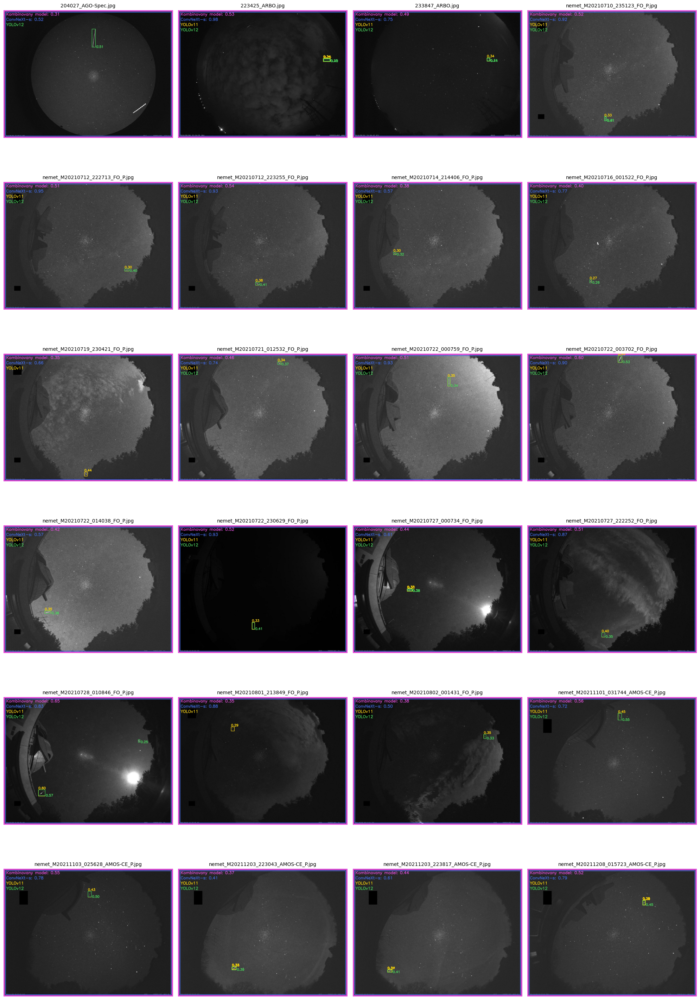

Mriežka uložená do: /home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/ensemble_learning/ensemble_learning_sporne_obrazky_.jpg


In [ ]:
output_dir = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/ensemble_learning/false_positives"
save_path = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/ensemble_learning/ensemble_learning_false_positives.jpg"  # Uloženie mriežky

image_files = sorted([
    os.path.join(output_dir, f) for f in os.listdir(output_dir) 
    if f.lower().endswith(('.jpg', '.jpeg', '.png'))
])

# Grid parameters
num_images = len(image_files)
columns = 4
rows = (num_images // columns) + (num_images % columns > 0)

fig, axes = plt.subplots(rows, columns, figsize=(20, 5 * rows))  # Dynamic size of canvas

for idx, img_path in enumerate(image_files):
    image = cv2.imread(img_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    row, col = divmod(idx, columns)
    
    axes[row, col].imshow(image)
    axes[row, col].axis("off")  # hide axes
    axes[row, col].set_title(os.path.basename(img_path), fontsize=10)

# Hide empty subplots (if less than 4xN)
for i in range(num_images, rows * columns):
    fig.delaxes(axes.flatten()[i])

plt.tight_layout()
plt.savefig(save_path, dpi=300, bbox_inches="tight")
plt.show()

print(f"Mriežka uložená do: {save_path}")

### Analyse false negatives

In [ ]:
threshold = 0.35

tn_filtered_df = df[
    (df["ensemble_prediction"] != df["true_label"]) &
    (df["ensemble_probability"] < threshold)
]

print("❌ Nesprávne klasifikované riadky s confidence nad thresholdom:")
tn_filtered_df

❌ Nesprávne klasifikované riadky s confidence nad thresholdom:


,image_name,true_label,prediction_ConvNexts,prediction_yolov11,prediction_yolov12,ensemble_probability,ensemble_prediction
300,M20210710_222230_FO_P.jpg,1,0.444450,0.00000,0.000000,0.122903,0
306,M20210711_003402_FO_P.jpg,1,0.794197,0.32774,0.000000,0.346076,0
393,M20210724_010235_FO_P.jpg,1,0.182895,0.00000,0.000000,0.050575,0
397,M20210724_205231_FO_P.jpg,1,0.161909,0.00000,0.000000,0.044772,0
488,M20210802_201151_FO_P.jpg,1,0.813556,0.00000,0.000000,0.224971,0
511,M20210802_224734_FO_P.jpg,1,0.656372,0.00000,0.000000,0.181505,0
548,M20210804_003147_FO_P.jpg,1,0.784201,0.00000,0.000000,0.216854,0
603,M20211030_012027_AMOS-CE_P.jpg,1,0.617275,0.00000,0.251963,0.255762,0
620,M20211030_211711_AMOS-CE_P.jpg,1,0.882865,0.00000,0.000000,0.244137,0
648,M20211031_223644_AMOS-CE_P.jpg,1,0.720946,0.00000,0.291194,0.297675,0


In [ ]:
import pandas as pd
import plotly.graph_objects as go

image_names = tn_filtered_df["image_name"]
convnext_preds = tn_filtered_df["prediction_ConvNexts"]
yolo11_preds = tn_filtered_df["prediction_yolov11"]
yolo12_preds = tn_filtered_df["prediction_yolov12"]
ensemble_predictions = tn_filtered_df["ensemble_probability"]

royal_blue = '#4169E1'
yellow = '#FFD700'
light_gray = '#F5F5F5'
magenta = '#E34FDC'
green = '#47D45A'

fig = go.Figure()

fig.add_trace(go.Bar(x=image_names, y=convnext_preds, name="ConvNext-S", marker_color=royal_blue))
fig.add_trace(go.Bar(x=image_names, y=yolo11_preds, name="YOLOv11", marker_color=yellow))
fig.add_trace(go.Bar(x=image_names, y=yolo12_preds, name="YOLOv12", marker_color=green))

fig.add_trace(go.Scatter(x=image_names, y=ensemble_predictions, mode='lines+markers',
                         name="Kombinovaná pravdepodobnosť",
                         line=dict(color=magenta, width=2), marker=dict(size=6)))

fig.add_shape(
    type="line",
    x0=-0.5, x1=len(image_names)-0.5,
    y0=0.3, y1=0.3,
    line=dict(color="black", width=2, dash="dash")
)

fig.add_trace(go.Scatter(
    x=[None], y=[None],
    mode='lines',
    line=dict(color="black", width=2, dash="dash"),
    name="Prah 0.35"
))

fig.update_layout(
    title="Analýza falošne negatívnych predikcií po aplikovaní posilňovaného učenia",
    xaxis_title="Obrázky",
    yaxis_title="Predikované pravdepodobnosti",
    xaxis_tickangle=-90,
    barmode='group',
    plot_bgcolor=light_gray,
    legend_title="Modely",
    width=1200,
    height=600
)

fig.show()


In [ ]:
test_images_dir = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/najlepsie_modely/vyhodnotenie/test_yolo/images"
output_dir = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/ensemble_learning/false_negatives"
model_path_convnext = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/najlepsie_modely/najlepsie_modely/datasetv2_best_convnext_model_v5.pth"
model_path_yolov12 = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/najlepsie_modely/najlepsie_modely/yolov12_vacsie_obrazky.pt"
model_path_yolov11 = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/najlepsie_modely/najlepsie_modely/yolov11_vacsie_obrazky.pt"
ensemble_csv_path = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/ensemble_learning/all_predictions_ensemble.csv"

royal_blue = (225, 105, 65)  # ConvNeXt
yellow = (0, 215, 255)       # YOLOv11
green = (90, 212, 71)        # YOLOv12
magenta = (220, 79, 227)     # Combined model

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

ensemble_df = pd.read_csv(ensemble_csv_path)

convnext_model = timm.create_model("convnext_small", pretrained=False, num_classes=1).to(device)
convnext_model.classifier = torch.nn.Sequential(
    torch.nn.Dropout(0.5),
    torch.nn.Linear(convnext_model.num_features, 1)
)
convnext_model.load_state_dict(torch.load(model_path_convnext, map_location=device))
convnext_model.eval()

transform = transforms.Compose([
    transforms.Resize((512, 512)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

yolo_model_11 = YOLO(model_path_yolov11).to(device)
yolo_model_12 = YOLO(model_path_yolov12).to(device)
yolo_model_11.eval()
yolo_model_12.eval()

def predict_convnext(image_path):
    image = Image.open(image_path).convert('RGB')
    image = transform(image).unsqueeze(0).to(device)
    with torch.no_grad():
        output = torch.sigmoid(convnext_model(image))
        probability = output.item()
    return probability

def predict_yolo(image_path, model, threshold=0.3):
    with torch.no_grad():
        results = model(image_path, verbose=False)
        detections = results[0].boxes

    boxes = []
    for det in detections.data.cpu().numpy():
        x1, y1, x2, y2, conf = det[:5]
        if conf > threshold:
            boxes.append((x1, y1, x2, y2, conf))
    return boxes

def convert_yolo_bbox(x_center, y_center, width, height, img_width, img_height):
    x1 = int((x_center - width / 2) * img_width)
    y1 = int((y_center - height / 2) * img_height)
    x2 = int((x_center + width / 2) * img_width)
    y2 = int((y_center + height / 2) * img_height)
    return x1, y1, x2, y2

os.makedirs(output_dir, exist_ok=True)

for img_name in tqdm(tn_filtered_df["image_name"], desc="Spracovanie obrázkov"):
    img_path = os.path.join(test_images_dir, img_name)
    if not os.path.exists(img_path):
        print(f"Obrázok {img_name} neexistuje.")
        continue

    pred_convnext = predict_convnext(img_path)
    pred_yolo11 = predict_yolo(img_path, yolo_model_11, threshold=0.2)
    pred_yolo12 = predict_yolo(img_path, yolo_model_12, threshold=0.2)

    ensemble_row = ensemble_df.loc[ensemble_df["image_name"] == img_name, "ensemble_probability"]
    ensemble_pred = ensemble_row.values[0] if not ensemble_row.empty else None

    image = cv2.imread(img_path)
    original_height, original_width = image.shape[:2]
    target_width, target_height = 1280, 960
    scale_x = target_width / original_width
    scale_y = target_height / original_height
    image = cv2.resize(image, (target_width, target_height))

    image = cv2.copyMakeBorder(image, 10, 10, 10, 10, cv2.BORDER_CONSTANT, value=magenta)

    image = cv2.rectangle(image, (15, 15), (target_width + 5, target_height + 5), royal_blue, 4)

    font = cv2.FONT_HERSHEY_SIMPLEX
    y_offset = 40
    font_scale = 1
    thickness = 2

    if ensemble_pred is not None:
        cv2.putText(image, f"Kombinovany model: {ensemble_pred:.2f}", (20, y_offset), font, font_scale, magenta, thickness, cv2.LINE_AA)
        y_offset += 40

    cv2.putText(image, f"ConvNeXt-s: {pred_convnext:.2f}", (20, y_offset), font, font_scale, royal_blue, thickness, cv2.LINE_AA)
    y_offset += 40

    if pred_yolo11:
        cv2.putText(image, "YOLOv11", (20, y_offset), font, font_scale, yellow, thickness, cv2.LINE_AA)
        y_offset += 40

    if pred_yolo12:
        cv2.putText(image, "YOLOv12", (20, y_offset), font, font_scale, green, thickness, cv2.LINE_AA)
        y_offset += 40

    for x1, y1, x2, y2, conf in pred_yolo11:
        if x1 < 1 and y1 < 1:
            x1, y1, x2, y2 = convert_yolo_bbox(x1, y1, x2 - x1, y2 - y1, original_width, original_height)
        x1, x2 = int(x1 * scale_x) + 10, int(x2 * scale_x) + 10
        y1, y2 = int(y1 * scale_y) + 10, int(y2 * scale_y) + 10
        cv2.rectangle(image, (x1, y1), (x2, y2), yellow, 2)
        cv2.putText(image, f"{conf:.2f}", (x1, y1 - 5), font, 0.8, yellow, 2, cv2.LINE_AA)

    for x1, y1, x2, y2, conf in pred_yolo12:
        if x1 < 1 and y1 < 1:
            x1, y1, x2, y2 = convert_yolo_bbox(x1, y1, x2 - x1, y2 - y1, original_width, original_height)
        x1, x2 = int(x1 * scale_x) + 10, int(x2 * scale_x) + 10
        y1, y2 = int(y1 * scale_y) + 10, int(y2 * scale_y) + 10
        cv2.rectangle(image, (x1, y1), (x2, y2), green, 2)
        cv2.putText(image, f"{conf:.2f}", (x2 + 5, y2 + 5), font, 0.8, green, 2, cv2.LINE_AA)

    output_path = os.path.join(output_dir, img_name)
    cv2.imwrite(output_path, image)

print("✅ Hotovo! Všetky obrázky spracované a uložené.")

Spracovanie obrázkov: 100%|██████████| 12/12 [00:16<00:00,  1.39s/it]

✅ Hotovo! Všetky obrázky spracované a uložené.


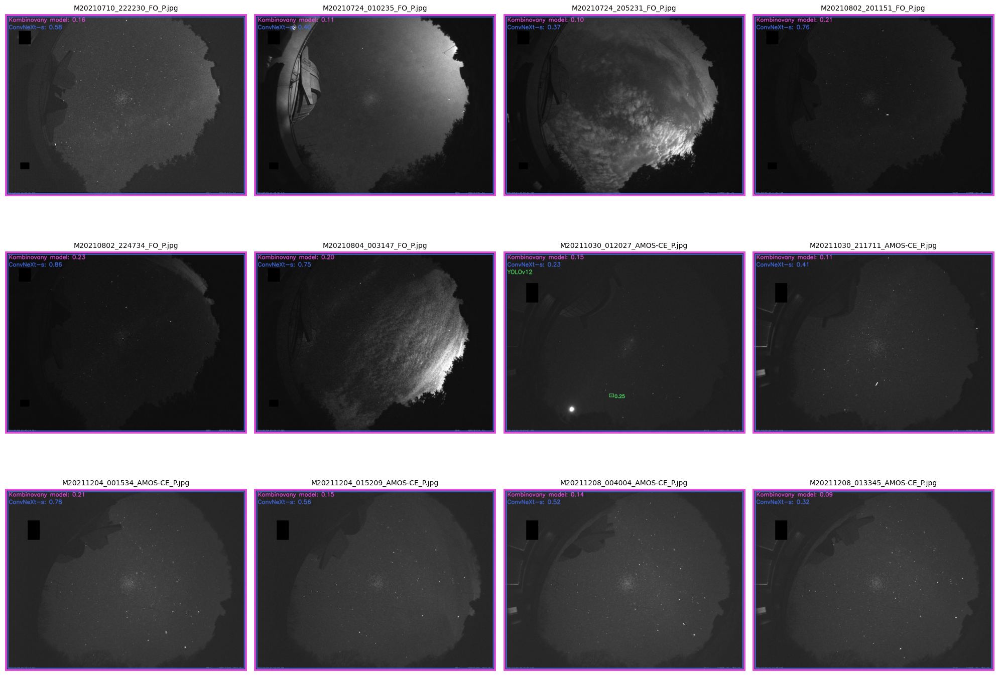

Mriežka uložená do: /home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/ensemble_learning/ensemble_learning_false_negatives.jpg


In [ ]:
output_dir = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/ensemble_learning/false_negatives"
save_path = "/home/jovyan/data/lightning/LiviaMurankova/new/namnozene_meteory/ensemble_learning/ensemble_learning_false_negatives.jpg"  # Uloženie mriežky

image_files = sorted([
    os.path.join(output_dir, f) for f in os.listdir(output_dir) 
    if f.lower().endswith(('.jpg', '.jpeg', '.png'))
])

num_images = len(image_files)
columns = 4
rows = (num_images // columns) + (num_images % columns > 0)

fig, axes = plt.subplots(rows, columns, figsize=(20, 5 * rows))

for idx, img_path in enumerate(image_files):
    image = cv2.imread(img_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    row, col = divmod(idx, columns)
    
    axes[row, col].imshow(image)
    axes[row, col].axis("off")
    axes[row, col].set_title(os.path.basename(img_path), fontsize=10)

for i in range(num_images, rows * columns):
    fig.delaxes(axes.flatten()[i])

plt.tight_layout()
plt.savefig(save_path, dpi=300, bbox_inches="tight")
plt.show()

print(f"Mriežka uložená do: {save_path}")